In [1]:
!pip install shap
!pip install lime
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 3.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283835 sha256=8842054ce1df2e59a5b25d3cf4e11fbc2065afad59ec383d2728b1e3bd886da8
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 25.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 26.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 37.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 37.4 MB/s eta 0:00:00


In [2]:
import shap
import pickle
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.naive_bayes import MultinomialNB, GaussianNB, CategoricalNB
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.ensemble import RandomForestClassifier

# LIME packages
from lime import lime_text
from lime.lime_text import LimeTextExplainer
from sklearn.pipeline import make_pipeline
from lime.lime_text import IndexedString,IndexedCharacters
from lime.lime_base import LimeBase
from sklearn.linear_model import Ridge, lars_path
from lime.lime_text import explanation
from functools import partial
import scipy as sp
from sklearn.utils import check_random_state
from sklearn.metrics import classification_report, confusion_matrix

from transformers import AutoTokenizer, TFAutoModel
import tensorflow as tf
from tqdm import tqdm

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


In [3]:
!pip install gdown

In [4]:
'''
https://drive.google.com/file/d/1x_D1Feh88EFHQ63SEe55sAymUnztqzeK/view?usp=drivesdk
https://drive.google.com/file/d/1Kqf7-0Jkp1doGJWyhgxW1ku738IO4xji/view?usp=drivesdk
'''

'\nhttps://drive.google.com/file/d/1x_D1Feh88EFHQ63SEe55sAymUnztqzeK/view?usp=drivesdk\nhttps://drive.google.com/file/d/1Kqf7-0Jkp1doGJWyhgxW1ku738IO4xji/view?usp=drivesdk\n'

In [5]:
!gdown 1x_D1Feh88EFHQ63SEe55sAymUnztqzeK
!gdown 1Kqf7-0Jkp1doGJWyhgxW1ku738IO4xji

Downloading...
From: https://drive.google.com/uc?id=1x_D1Feh88EFHQ63SEe55sAymUnztqzeK
To: /content/train.pkl
100% 3.59M/3.59M [00:00<00:00, 41.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1Kqf7-0Jkp1doGJWyhgxW1ku738IO4xji
To: /content/test.pkl
100% 762k/762k [00:00<00:00, 49.6MB/s]


In [6]:
FILE_PATH = "train.pkl"

with open(FILE_PATH, 'rb') as f:
    df_train = pickle.load(f)

In [7]:
FILE_PATH = "test.pkl"

with open(FILE_PATH, 'rb') as f:
    df_test = pickle.load(f)

In [8]:
df_train.reset_index(drop = True, inplace = True)
df_test.reset_index(drop = True, inplace = True)

In [9]:
df_train.head()

,tweet,label,tweet_with_out_emojis,cleaned_data,Root Stemming,Light Stemming
0,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,1,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,مهند ياحبيبي تدور لبش اي احد متاكد ابو ...,هند حبب تدر لبش اي احد تكد ابو جسم ايدر,مهند ياحبيبي تدور لبش اي احد متاكد ابو جاسم ما...
1,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,3,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,حلب عفرين اعتقال عشرات الشباب قريه باسوطه ريف ...,حلب عفر عقل عشر شبب قره بسط ريف عفر قوت هرب عش...,حلب عفر اعتقال عشر الشباب قريه باسوطه ريف عفر ...
2,انا نفسي مره اجرب اكون ليك حد اقرب : ),3,انا نفسي مره اجرب اكون ليك حد اقرب : ),مره اجرب اكون ليك اقرب,مره جرب اكن ليك قرب,مره اجرب اكون ليك اقرب
3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,صرح حسس خزي كتف مثل شرف اوليمبياد عوز صحه ريض,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...
4,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,0,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...,عجل يطل ابو بسل يفز دهب اوليمبياد جودو بطل علم...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...


In [10]:
marbert_model_path = 'UBC-NLP/MARBERT'
tokenizer = AutoTokenizer.from_pretrained(marbert_model_path, from_tf=True)
marbert_model = TFAutoModel.from_pretrained(marbert_model_path, output_hidden_states=True)

All model checkpoint layers were used when initializing TFBertModel.

All the layers of TFBertModel were initialized from the model checkpoint at UBC-NLP/MARBERT.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFBertModel for predictions without further training.


In [11]:
remove_special_tokens=1 #change this to 0 if you want to keep the special token
stemtype = 'Light Stemming'

In [12]:
def bert_tokenize(text: str) -> dict:
  tokens = tokenizer(text, padding='max_length', truncation=True, max_length=50)
  if remove_special_tokens == 1:
    shape = np.array(tokens['input_ids']).shape
    modified_input_ids = np.zeros(shape).astype(np.int32)
    modified_attention_mask = np.zeros(shape).astype(np.int32)
    # Modify the input IDs and attention mask as per your requirement
    for i in range(shape[0]):
      modified_input_ids[i] = [0 if token_id == 1 else 0 if token_id == 3 else 0 if token_id == 0 else 0 if token_id == 2 else 0 if token_id == 4 else token_id for token_id in tokens['input_ids'][i]]
      modified_attention_mask[i] = [0 if token_id in [1, 3, 0, 2, 4] else 1 for token_id in tokens['input_ids'][i]]
    # Update the input IDs and attention mask in the tokens dictionary
    tokens['input_ids'] = modified_input_ids
    tokens['attention_mask'] = modified_attention_mask
  return tokens

In [13]:
def get_embeddings(ids, mask, type_ids):
  ids = tf.convert_to_tensor(ids)
  mask = tf.convert_to_tensor(mask)
  type_ids = tf.convert_to_tensor(type_ids)
  hidden_states = marbert_model(input_ids=ids, attention_mask=mask, token_type_ids=type_ids)[0]
  averaged_embedding = tf.reduce_mean(hidden_states, axis=1)
  return averaged_embedding.numpy()

In [14]:
label_to_class = [
    'none',
    'anger',
    'joy',
    'sadness',
    'love',
    'sympathy',
    'surprise',
    'fear'
]
label_to_class_dic = {
    0:'none',
    1:'anger',
    2:'joy',
    3:'sadness',
    4:'love',
    5:'sympathy',
    6:'surprise',
    7:'fear'
}

In [15]:
def map_label_to_class(indices, classes):
  return [classes[idx] for idx in indices]

In [16]:
def create_confusion_matrix(y_pred):
  # creatin a confusion matrix
  y_true = map_label_to_class(df_test['label'], label_to_class)
  y_pred = map_label_to_class(y_pred, label_to_class)
  cm = confusion_matrix(y_true, y_pred, labels=label_to_class)
  # create a DataFrame for the confusion matrix with class names as index and columns
  cm_df = pd.DataFrame(cm, index=label_to_class, columns=label_to_class)

  # create a heatmap for visualization
  plt.figure(figsize=(5, 5))
  sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
  plt.xlabel('Predicted')
  plt.ylabel('True')
  plt.title('Confusion Matrix')
  plt.show()

In [17]:
x_train = df_train[stemtype].values.astype(str).tolist()
x_train = bert_tokenize(x_train)

xlen = np.array(x_train['input_ids']).shape[0]

In [18]:
x_train_emb = np.zeros((xlen,768))
for i in range(0,xlen,100):
  if(i+100 < xlen):
    input_ids = x_train['input_ids'][i:i+100]
    attention_mask = x_train['attention_mask'][i:i+100]
    token_type_ids = x_train['token_type_ids'][i:i+100]
    x_train_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
  else:
    input_ids = x_train['input_ids'][i:xlen]
    attention_mask = x_train['attention_mask'][i:xlen]
    token_type_ids = x_train['token_type_ids'][i:xlen]
    x_train_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)

In [19]:
x_test = df_test[stemtype].values.astype(str).tolist()
x_test = bert_tokenize(x_test)

xlen = np.array(x_test['input_ids']).shape[0]

In [20]:
x_test_emb = np.zeros((xlen,768))
for i in range(0,xlen,100):
  if(i+100 < xlen):
    input_ids = x_test['input_ids'][i:i+100]
    attention_mask = x_test['attention_mask'][i:i+100]
    token_type_ids = x_test['token_type_ids'][i:i+100]
    x_test_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
  else:
    input_ids = x_test['input_ids'][i:xlen]
    attention_mask = x_test['attention_mask'][i:xlen]
    token_type_ids = x_test['token_type_ids'][i:xlen]
    x_test_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)

## Naive Bayes

In [21]:
nb_ls = GaussianNB(var_smoothing=1e-6)
nb_ls.fit(x_train_emb, df_train['label'])

# test accuracy of light stemming embeddings
y_pred = nb_ls.predict(x_test_emb)
# calculating the accuracy of the classifier
accuracy = accuracy_score(df_test['label'], y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.4960264900662252


In [22]:
print(classification_report(df_test['label'], y_pred, target_names = label_to_class))

              precision    recall  f1-score   support

        none       0.55      0.86      0.67       229
       anger       0.43      0.58      0.50       200
         joy       0.37      0.24      0.29       205
     sadness       0.35      0.24      0.28       185
        love       0.48      0.64      0.55       193
    sympathy       0.63      0.51      0.57       156
    surprise       0.36      0.28      0.32       154
        fear       0.76      0.52      0.62       188

    accuracy                           0.50      1510
   macro avg       0.49      0.48      0.47      1510
weighted avg       0.49      0.50      0.48      1510



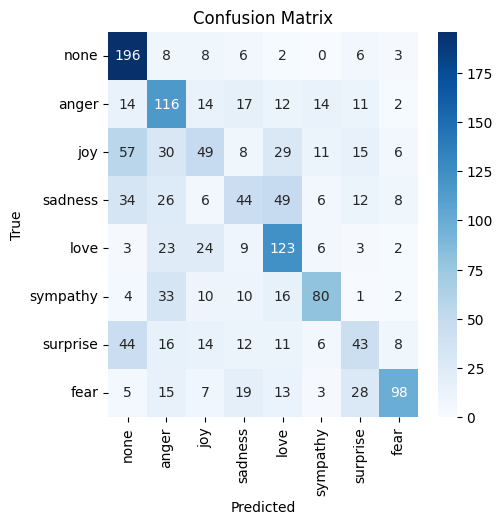

In [23]:
create_confusion_matrix(y_pred)

## LIME

In [24]:
def model_predict(text):
  tokens = bert_tokenize(text)
  xlen = np.array(tokens['input_ids']).shape[0]
  x_emb = np.zeros((xlen,768))
  for i in range(0,xlen,100):
    if(i+100 < xlen):
      input_ids = tokens['input_ids'][i:i+100]
      attention_mask = tokens['attention_mask'][i:i+100]
      token_type_ids = tokens['token_type_ids'][i:i+100]
      x_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
      input_ids = tokens['input_ids'][i:xlen]
      attention_mask = tokens['attention_mask'][i:xlen]
      token_type_ids = tokens['token_type_ids'][i:xlen]
      x_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)
  return nb_ls.predict_proba(x_emb)

## SHAP

In [25]:
def shap_model_predict(text):
  text = text.astype(str).tolist()
  tokens = bert_tokenize(text)
  xlen = np.array(tokens['input_ids']).shape[0]
  x_emb = np.zeros((xlen,768))
  for i in range(0,xlen,100):
    if(i+100 < xlen):
      input_ids = tokens['input_ids'][i:i+100]
      attention_mask = tokens['attention_mask'][i:i+100]
      token_type_ids = tokens['token_type_ids'][i:i+100]
      x_emb[i:i+100] = get_embeddings(input_ids,attention_mask,token_type_ids)
    else:
      input_ids = tokens['input_ids'][i:xlen]
      attention_mask = tokens['attention_mask'][i:xlen]
      token_type_ids = tokens['token_type_ids'][i:xlen]
      x_emb[i:xlen] = get_embeddings(input_ids,attention_mask,token_type_ids)
  return nb_ls.predict_proba(x_emb)

In [26]:
'''
function that initializes shap with the appropriate model
parameters
model: an instance of your model, ex: LogisticRegression instance
'''
def initializeShap(model):
  # split input text into tokens
  masker = shap.maskers.Text(tokenizer=r"\W+")
  explainer = shap.Explainer(shap_model_predict, masker=masker, output_names=label_to_class)
  return explainer

In [27]:
nb_explainer = initializeShap(model=nb_ls)

## Exploration

In [28]:
tp = df_test['label'] != y_pred

In [29]:
tp = ((df_test['label'] == 7)*tp)

In [30]:
tp[tp == True]

0       True
4       True
5       True
16      True
33      True
        ... 
1394    True
1414    True
1431    True
1487    True
1502    True
Name: label, Length: 90, dtype: bool

In [31]:
label_to_class

['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear']

In [32]:
def explain_example_lime(i):
  instance = df_test[stemtype].iloc[i]
  print("True label: ", label_to_class[df_test['label'].iloc[i]])
  print("Original tweet: ", df_test['tweet'].iloc[i])
  # creating a LimeTextExplainer
  explainer = LimeTextExplainer(class_names=label_to_class)

  # explaining the prediction
  explanation = explainer.explain_instance(instance, model_predict, num_features=10, labels = range(8))

  # showing the explanation
  explanation.show_in_notebook()

In [33]:
def explain_example_shap(i):
  instance = df_test[stemtype].iloc[i:i+1].values.astype(str).tolist()
  print("True label: ", label_to_class[df_test['label'].iloc[i]])
  print("Original tweet: ", df_test['tweet'].iloc[i])
  shap_values = nb_explainer(instance)
  shap.text_plot(shap_values)

## Label None predicted correctly

In [51]:
explain_example_lime(3)

True label:  none
Original tweet:  نفسي اشوف قطري جد جد مشارك في الاوليمبياد نفس الشئ ينطبق علي الفرنسيين


In [52]:
explain_example_shap(3)

True label:  none
Original tweet:  نفسي اشوف قطري جد جد مشارك في الاوليمبياد نفس الشئ ينطبق علي الفرنسيين


## Label None predicted incorrectly

In [54]:
explain_example_lime(83)

True label:  none
Original tweet:  سباح تونسي ف الاوليمبياد طلع ف المركز الاخير . واحد تونسي مشارك الخبر وكاتب الحمد لله انه ما غرقش 😂😂


In [55]:
explain_example_shap(83)

True label:  none
Original tweet:  سباح تونسي ف الاوليمبياد طلع ف المركز الاخير . واحد تونسي مشارك الخبر وكاتب الحمد لله انه ما غرقش 😂😂


  0%|          | 0/272 [00:00<?, ?it/s]

## Label Anger predicted correctly

In [56]:
explain_example_lime(1)

True label:  anger
Original tweet:  tv علي عبدالله صالح صانع الوحده لا تنساء هذا واذكرك ان ازعيم لن يفرط في الوحده لو كلفته حياته. خليهاء في راسك مسمار مسمم


In [57]:
explain_example_shap(1)

True label:  anger
Original tweet:  tv علي عبدالله صالح صانع الوحده لا تنساء هذا واذكرك ان ازعيم لن يفرط في الوحده لو كلفته حياته. خليهاء في راسك مسمار مسمم


  0%|          | 0/272 [00:00<?, ?it/s]

## Label Anger predicted incorrectly

In [58]:
explain_example_lime(13)

True label:  anger
Original tweet:  السعوديه الثالثه في السمنه مفروض الاولي ب السمنه علي كثر ما يسوون تكميم ????????


In [59]:
explain_example_shap(13)

True label:  anger
Original tweet:  السعوديه الثالثه في السمنه مفروض الاولي ب السمنه علي كثر ما يسوون تكميم ????????


## Label Joy predicted correctly

In [60]:
explain_example_lime(31)

True label:  joy
Original tweet:  صوتك ده ايه الله عليه ملايكه بيغنوا ...


In [61]:
explain_example_shap(31)

True label:  joy
Original tweet:  صوتك ده ايه الله عليه ملايكه بيغنوا ...


## Label Joy predicted incorrectly

In [62]:
explain_example_lime(2)

True label:  joy
Original tweet:  الاوليمبياد السنه دي افشخ من سيدني اللي كنا بنزوغ من المدرسه علشان نتفرج عليها 😀


In [63]:
explain_example_shap(2)

True label:  joy
Original tweet:  الاوليمبياد السنه دي افشخ من سيدني اللي كنا بنزوغ من المدرسه علشان نتفرج عليها 😀


## Label Sadness predicted correctly

In [64]:
explain_example_lime(27)

True label:  sadness
Original tweet:  عيش لوحدك حتي لو هتموت احسن من انك تفرض نفسك علي حد مش عيزك


In [65]:
explain_example_shap(27)

True label:  sadness
Original tweet:  عيش لوحدك حتي لو هتموت احسن من انك تفرض نفسك علي حد مش عيزك


## Label Sadness predicted incorrectly

In [66]:
explain_example_lime(12)

True label:  sadness
Original tweet:  المصريين داخلين الاوليمبياد تمثيل مشرف


In [67]:
explain_example_shap(12)

True label:  sadness
Original tweet:  المصريين داخلين الاوليمبياد تمثيل مشرف


## Label Love predicted correctly

In [68]:
explain_example_lime(11)

True label:  love
Original tweet:  وما كنت ممن يدخل العشقَ قلبهُ ولكن من يبصر جفونكِ يعشقُ  تصميمي  تصميم  رمزيات  جده  صباح الخير  مساء الخير…


In [69]:
explain_example_shap(11)

True label:  love
Original tweet:  وما كنت ممن يدخل العشقَ قلبهُ ولكن من يبصر جفونكِ يعشقُ  تصميمي  تصميم  رمزيات  جده  صباح الخير  مساء الخير…


## Label Love predicted incorrectly

In [70]:
explain_example_lime(15)

True label:  love
Original tweet:  وائل كفوري  عششششششق 🙈 اتمني ان اتخلص منه لادخل الجنه 😢💔  Admin👸


In [71]:
explain_example_shap(15)

True label:  love
Original tweet:  وائل كفوري  عششششششق 🙈 اتمني ان اتخلص منه لادخل الجنه 😢💔  Admin👸


## Label Sympathy predicted correctly

In [72]:
explain_example_lime(32)

True label:  sympathy
Original tweet:  o:  تراجف ايديني من البرد وقول الله يكون بعون اخوننا ب  العراق و و  اليمن اللهم ان الكل خذلهم فانصرهم يارب 💔🙏🏻


In [73]:
explain_example_shap(32)

True label:  sympathy
Original tweet:  o:  تراجف ايديني من البرد وقول الله يكون بعون اخوننا ب  العراق و و  اليمن اللهم ان الكل خذلهم فانصرهم يارب 💔🙏🏻


  0%|          | 0/240 [00:00<?, ?it/s]

## Label Sympathy predicted incorrectly

In [74]:
explain_example_lime(19)

True label:  sympathy
Original tweet:  اه لو نبطل نفسنه من الي كان فقير وربنا كرمه او من الي معاه فلوس او اي حاجه نفسنا فيها ومش قادرين نجيبها  حب لاخيك ما تحب لنفسك


In [75]:
explain_example_shap(19)

True label:  sympathy
Original tweet:  اه لو نبطل نفسنه من الي كان فقير وربنا كرمه او من الي معاه فلوس او اي حاجه نفسنا فيها ومش قادرين نجيبها  حب لاخيك ما تحب لنفسك


  0%|          | 0/380 [00:00<?, ?it/s]

Partition explainer: 2it [00:13, 13.29s/it]               


## Label Surprise predicted correctly

In [76]:
explain_example_lime(17)

True label:  surprise
Original tweet:  مش معقووول .. اهنيك علي هذي الموهبه .. ابداع يفوق الوصف


In [77]:
explain_example_shap(17)

True label:  surprise
Original tweet:  مش معقووول .. اهنيك علي هذي الموهبه .. ابداع يفوق الوصف


## Label Surprise explained incorrectly

In [78]:
explain_example_lime(34)

True label:  surprise
Original tweet:  اوليمبياد ريو غريب وعجيب لا احد يسال لماذا غابت الفروسيه السعوديه وهي ثروتنا وعزنا ومجدنا عن الاوليمبياد ومن المسؤول


In [79]:
explain_example_shap(34)

True label:  surprise
Original tweet:  اوليمبياد ريو غريب وعجيب لا احد يسال لماذا غابت الفروسيه السعوديه وهي ثروتنا وعزنا ومجدنا عن الاوليمبياد ومن المسؤول


  0%|          | 0/240 [00:00<?, ?it/s]

## Label Fear predicted correctly

In [80]:
explain_example_lime(22)

True label:  fear
Original tweet:  n alroqi: فيني من الله قلي كيف ما فيك خوف . . سلطان بن نايف


In [81]:
explain_example_shap(22)

True label:  fear
Original tweet:  n alroqi: فيني من الله قلي كيف ما فيك خوف . . سلطان بن نايف


## Label Fear predicted incorrectly

In [82]:
explain_example_lime(33)

True label:  fear
Original tweet:  حقيقي انا خايفه من التغير الجاي اكتر من نتيجه الماتش


In [83]:
explain_example_shap(33)

True label:  fear
Original tweet:  حقيقي انا خايفه من التغير الجاي اكتر من نتيجه الماتش
